# Performs k-means clustering with marker intensity values in selected cells

In [1]:
import os
import glob
from pathlib import Path 
import sys
import fnmatch
from itertools import cycle
from functools import partial
from math import log10, sqrt, ceil, floor, log, exp, pi, isnan
import numpy as np
import numpy.ma as ma
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.patches as mpatches
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
fontprops = fm.FontProperties(size=30)
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1 import make_axes_locatable
import cmapy
import tifffile
import pandas as pd
import cv2
from scipy import fftpack
from scipy import ndimage
from scipy import stats
from scipy.spatial import distance
from scipy.cluster import hierarchy
from scipy.signal import convolve2d
import seaborn as sns
from tqdm.notebook import tqdm, trange
from skimage import color
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import RobustScaler, StandardScaler
from sklearn.manifold import TSNE
from skimage.transform import rescale
from skimage.util import view_as_windows
from skimage.feature import canny
from skimage.metrics import mean_squared_error as mse
from skimage.metrics import structural_similarity as ssim
from statannot import add_stat_annotation
import scipy
import pickle
import time

import multiprocessing as mp
from multiprocessing import Process, Queue, Value, Array, Pool

import matplotlib.font_manager as fm
%matplotlib inline
plt.rcParams["axes.grid"] = False
%gui qt5

In [2]:
# Import path
module_path = str(Path.cwd().parents[0])
if module_path not in sys.path:
    sys.path.append(module_path)

module_path = str(Path.cwd().parents[0] / "src")
if module_path not in sys.path:
    sys.path.append(module_path)

In [3]:
from my_io import display_list_image, read_tiff_files
from config import *

In [4]:
# Figures location    
save_path = f"{data_figure}/clustering/"
if not os.path.exists(save_path):
    os.makedirs(save_path)

### Load the datasets

In [5]:
pickle_name_temp = f"{data_path_masked_BM}/image_list_BM.pickle"
zoomed_image_list_BM = pickle.load(open(pickle_name_temp, "rb"))

pickle_name_temp = f"{data_path_masked_UC}/image_list_UC.pickle"
zoomed_image_list_UC = pickle.load(open(pickle_name_temp, "rb"))

In [6]:
pickle_name_temp = f"{data_path_masked_BM}/mask_list_BM.pickle"
zoomed_mask_list_BM = pickle.load(open(pickle_name_temp, "rb"))

pickle_name_temp = f"{data_path_masked_UC}/mask_list_UC.pickle"
zoomed_mask_list_UC = pickle.load(open(pickle_name_temp, "rb"))

In [7]:
pickle_name_temp = f"{data_path_masked_BM}/bounding_list_BM.pickle"
bounding_list_BM = pickle.load(open(pickle_name_temp, "rb"))

pickle_name_temp = f"{data_path_masked_UC}/bounding_list_UC.pickle"
bounding_list_UC = pickle.load(open(pickle_name_temp, "rb"))

In [8]:
organnelle_names = ['mitochondria', 'endoplasmic_reticulum', 'nucleus', 
                    'golgi', 'plasma_membrane']

organnelle_names_plot = ['Mitochondria', 'Endoplasmic Reticulum', 'Nucleus', 
                    'Golgi', 'Plasma Membrane']
channel_cluster = channel_names_modif

In [9]:
BM_indices = [2, 3, 8, 14, 18, 29, 30]
UC_indices = [0, 3, 9, 11, 19, 23, 30]

In [10]:
df_images_all_BM = pd.DataFrame()

q = 0.9

for x in trange(len(BM_indices)):
    m = BM_indices[x]
    pd_images = pd.DataFrame()
    images_temp = zoomed_image_list_BM[m].copy()
    masks_temp = zoomed_mask_list_BM[m].copy()/255
    
    array_i_index = np.zeros(images_temp[0].shape)
    array_j_index = np.zeros(images_temp[0].shape)
    for i in range(array_i_index.shape[0]):
        for j in range(array_i_index.shape[1]):
            array_i_index[i, j] = i
            array_j_index[i, j] = j
            
    pd_images_temp = pd.DataFrame(images_temp.reshape(11, -1).T, columns=channel_names)
    
    pd_images_temp['mitochondria'] = pd_images_temp['HSP60'] * pd_images_temp['TOM20']
    pd_images_temp['endoplasmic_reticulum'] = pd_images_temp['ATF6'] * pd_images_temp['ConcanavalinA']
    pd_images_temp['nucleus'] = pd_images_temp['Nucleolin'] * pd_images_temp['DAPI'] 
    pd_images_temp['golgi'] = pd_images_temp['GOLPH4'] * pd_images_temp['WGA']
    pd_images_temp['plasma_membrane'] = pd_images_temp['WGA']
    
    
    pd_images_temp['cell'] = x
    pd_images_temp['mask'] = masks_temp.reshape(-1).copy()
    pd_images_temp['index_i'] = array_i_index.reshape(-1)
    pd_images_temp['index_j'] = array_j_index.reshape(-1)
    
    pd_images_temp = pd_images_temp[pd_images_temp['mask'] == 1.0]
    
    pd_images_temp = pd_images_temp[channel_names + ['cell', 'index_i', 'index_j'] + organnelle_names]
        
    df_images_all_BM = pd.concat([df_images_all_BM, pd_images_temp], axis=0)

  0%|          | 0/7 [00:00<?, ?it/s]

In [11]:
df_images_all_UC = pd.DataFrame()
q = 0.9

for x in trange(len(UC_indices)):
    m = UC_indices[x]
    pd_images = pd.DataFrame()
    images_temp = zoomed_image_list_UC[m].copy()
    masks_temp = zoomed_mask_list_UC[m].copy()/255
    
    array_i_index = np.zeros(images_temp[0].shape)
    array_j_index = np.zeros(images_temp[0].shape)
    for i in range(array_i_index.shape[0]):
        for j in range(array_i_index.shape[1]):
            array_i_index[i, j] = i
            array_j_index[i, j] = j
            
    pd_images_temp = pd.DataFrame(images_temp.reshape(11, -1).T, columns=channel_names)
    
    pd_images_temp['mitochondria'] = pd_images_temp['HSP60'] * pd_images_temp['TOM20']
    pd_images_temp['endoplasmic_reticulum'] = pd_images_temp['ATF6'] * pd_images_temp['ConcanavalinA']
    pd_images_temp['nucleus'] = pd_images_temp['Nucleolin'] * pd_images_temp['DAPI'] 
    pd_images_temp['golgi'] = pd_images_temp['GOLPH4'] * pd_images_temp['WGA']
    pd_images_temp['plasma_membrane'] = pd_images_temp['WGA']
    
    
    pd_images_temp['cell'] = x
    pd_images_temp['mask'] = masks_temp.reshape(-1).copy()
    pd_images_temp['index_i'] = array_i_index.reshape(-1)
    pd_images_temp['index_j'] = array_j_index.reshape(-1)
    
    pd_images_temp = pd_images_temp[pd_images_temp['mask'] == 1.0]
    
    pd_images_temp = pd_images_temp[channel_names + ['cell', 'index_i', 'index_j'] + organnelle_names]
        
    df_images_all_UC = pd.concat([df_images_all_UC, pd_images_temp], axis=0)

  0%|          | 0/7 [00:00<?, ?it/s]

In [12]:
df_images_all_BM

,ATF6,BetaTubulin,ConcanavalinA,DAPI,GOLPH4,HSP60,Nucleolin,Phalloidin,Sortilin,TOM20,WGA,cell,index_i,index_j,mitochondria,endoplasmic_reticulum,nucleus,golgi,plasma_membrane
5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.509696,0.000000,0.000000,3.598631,0,0.0,5.0,0.000000,0.000000,0.000000,0.000000,3.598631
511,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.529918,0.000000,0.000000,3.308033,0,1.0,5.0,0.000000,0.000000,0.000000,0.000000,3.308033
512,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.024862,0.000000,0.000000,2.494359,0,1.0,6.0,0.000000,0.000000,0.000000,0.000000,2.494359
1016,0.000000,0.000000,0.000000,0.000000,0.000000,0.560966,0.000000,6.118265,0.000000,0.000000,5.051620,0,2.0,4.0,0.000000,0.000000,0.000000,0.000000,5.051620
1017,0.000000,0.000000,0.000000,0.000000,0.000000,0.085074,0.000000,4.633432,0.000000,0.000000,4.819141,0,2.0,5.0,0.000000,0.000000,0.000000,0.000000,4.819141
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
740206,11.958569,17.792951,7.188744,0.000000,4.515351,9.897884,5.495502,43.441347,23.321694,10.557888,40.349021,6,735.0,796.0,104.500755,85.967089,0.000000,182.189992,40.349021
741152,13.947322,57.935682,11.466156,21.605207,3.284354,7.360955,6.608191,41.528834,31.703089,6.368386,23.938258,6,736.0,736.0,46.877403,159.922173,142.771331,78.621708,23.938258
741153,9.969815,57.023347,12.450640,23.693506,0.959137,7.665387,3.455572,36.610946,34.690517,10.719023,22.879499,6,736.0,737.0,82.165456,124.130577,81.874617,21.944571,22.879499
741154,12.754070,49.268502,11.669842,25.364145,3.147576,7.868341,1.415642,33.059138,32.200994,5.562712,23.726506,6,736.0,738.0,43.769318,148.837987,35.906557,74.680989,23.726506


In [13]:
df_images_all_UC

,ATF6,BetaTubulin,ConcanavalinA,DAPI,GOLPH4,HSP60,Nucleolin,Phalloidin,Sortilin,TOM20,WGA,cell,index_i,index_j,mitochondria,endoplasmic_reticulum,nucleus,golgi,plasma_membrane
1677,4.641346,3.820185,3.101509,4.712155,3.948687,0.241399,1.914101,9.774886,0.000000,2.823490,7.004203,0,0.0,1677.0,0.681589,14.395176,9.019539,27.657405,7.004203
1678,10.054738,4.318076,4.605119,3.483368,4.152983,0.000000,0.968618,4.568408,2.196319,4.661432,1.902378,0,0.0,1678.0,0.000000,46.303259,3.374053,7.900543,1.902378
1679,9.668067,4.484039,8.364142,1.708453,2.518614,0.048280,0.000000,28.518207,4.353128,4.967756,6.323959,0,0.0,1679.0,0.239843,80.865084,0.000000,15.927612,6.323959
1680,5.414687,3.654222,7.612337,1.435389,1.292837,0.579359,0.495877,0.000000,3.873837,4.967756,5.983838,0,0.0,1680.0,2.878113,41.218426,0.711776,7.736125,5.983838
1681,24.361560,4.484039,7.361736,0.343134,1.497133,0.000000,2.623212,32.162742,7.947810,5.580403,2.922743,0,0.0,1681.0,0.000000,179.343366,0.900112,4.375734,2.922743
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1165712,13.268032,4.762141,8.236317,7.723168,1.303062,2.252841,15.690739,18.597225,6.194065,0.000000,2.629720,6,1229.0,620.0,0.000000,109.279720,121.182222,3.426690,2.629720
1165713,6.335506,4.762141,8.991986,9.274926,2.170195,2.252841,5.323868,19.885604,10.313653,0.000000,0.000000,6,1229.0,621.0,0.000000,56.968785,49.378481,0.000000,0.000000
1165714,15.743934,4.762141,9.243876,5.395531,0.000000,2.252841,7.450405,8.719652,15.348706,0.611906,1.287915,6,1229.0,622.0,1.378526,145.534972,40.198895,0.000000,1.287915
1165715,18.219836,5.079617,0.000000,6.947289,2.266543,1.646490,1.868244,6.572354,16.721902,2.472840,0.329484,6,1229.0,623.0,4.071506,0.000000,12.979230,0.746789,0.329484


In [14]:
df_images_BM = df_images_all_BM
df_images_BM['CellType'] = 'BM'
df_images_UC = df_images_all_UC
df_images_UC['CellType'] = 'UC'
df_images_all = pd.concat([df_images_BM, df_images_UC])

In [15]:
pickle_name_temp = f"{data_path_masked_BM}/images_all_BM.pickle"
with open(pickle_name_temp, 'wb') as f:
    pickle.dump(df_images_all_BM, f)

pickle_name_temp = f"{data_path_masked_UC}/images_all_UC.pickle"
with open(pickle_name_temp, 'wb') as f:
    pickle.dump(df_images_all_UC, f)

### K-means clustering

In [16]:
nb_cluster_all_BM = 10
nb_cluster_all_UC = 10

kmeans_pca_all_BM = KMeans(n_clusters=nb_cluster_all_BM, init = 'k-means++', random_state=2021, n_init=20)
kmeans_pca_scores_all_BM = kmeans_pca_all_BM.fit_predict(df_images_all_BM[channel_cluster])

df_segm_pca_means_all_BM = df_images_all_BM.copy()
df_segm_pca_means_all_BM['Seg_KMeans'] = kmeans_pca_scores_all_BM


kmeans_pca_all_UC = KMeans(n_clusters=nb_cluster_all_UC, init = 'k-means++', random_state=2021, n_init=20)
kmeans_pca_scores_all_UC = kmeans_pca_all_UC.fit_predict(df_images_all_UC[channel_cluster])

df_segm_pca_means_all_UC = df_images_all_UC.copy()
df_segm_pca_means_all_UC['Seg_KMeans'] = kmeans_pca_scores_all_UC

In [17]:
change_map = [0, 3]
clustered_arrays_all_BM = [np.zeros_like(zoomed_image_list_BM[cell][0]) for cell in BM_indices]
df_list_BM = []

df_selected_cell_no_marker_all_BM = df_segm_pca_means_all_BM[['cell', 'index_i', 'index_j', 'Seg_KMeans']]
df_selected_cell_no_marker_all_BM = df_selected_cell_no_marker_all_BM.copy()
df_selected_cell_no_marker_all_BM['Seg_KMeans_changed'] = df_selected_cell_no_marker_all_BM['Seg_KMeans']

df_selected_cell_no_marker_array_all_BM = df_selected_cell_no_marker_all_BM.to_numpy()

for line in trange(df_selected_cell_no_marker_array_all_BM.shape[0]):
    cell = int(df_selected_cell_no_marker_array_all_BM[line, 0])
    index_i = int(df_selected_cell_no_marker_array_all_BM[line, 1])
    index_j = int(df_selected_cell_no_marker_array_all_BM[line, 2])
    Seg_KMeans_PCA = int(df_selected_cell_no_marker_array_all_BM[line, 4])
    df_list_BM.append((cell,index_i,index_j,Seg_KMeans_PCA))
    clustered_arrays_all_BM[cell][index_i, index_j] = Seg_KMeans_PCA

  0%|          | 0/1815074 [00:00<?, ?it/s]

In [18]:
change_map = [0, 3]
clustered_arrays_all_UC = [np.zeros_like(zoomed_image_list_UC[cell][0]) for cell in UC_indices]
df_list_UC = []

df_selected_cell_no_marker_all_UC = df_segm_pca_means_all_UC[['cell', 'index_i', 'index_j', 'Seg_KMeans']]
df_selected_cell_no_marker_all_UC = df_selected_cell_no_marker_all_UC.copy()
df_selected_cell_no_marker_all_UC['Seg_KMeans_changed'] = df_selected_cell_no_marker_all_UC['Seg_KMeans']

df_selected_cell_no_marker_array_all_UC = df_selected_cell_no_marker_all_UC.to_numpy()

for line in trange(df_selected_cell_no_marker_array_all_UC.shape[0]):
    cell = int(df_selected_cell_no_marker_array_all_UC[line, 0])
    index_i = int(df_selected_cell_no_marker_array_all_UC[line, 1])
    index_j = int(df_selected_cell_no_marker_array_all_UC[line, 2])
    Seg_KMeans_PCA = int(df_selected_cell_no_marker_array_all_UC[line, 4])
    df_list_UC.append((cell,index_i,index_j,Seg_KMeans_PCA))
    clustered_arrays_all_UC[cell][index_i, index_j] = Seg_KMeans_PCA

  0%|          | 0/3027746 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

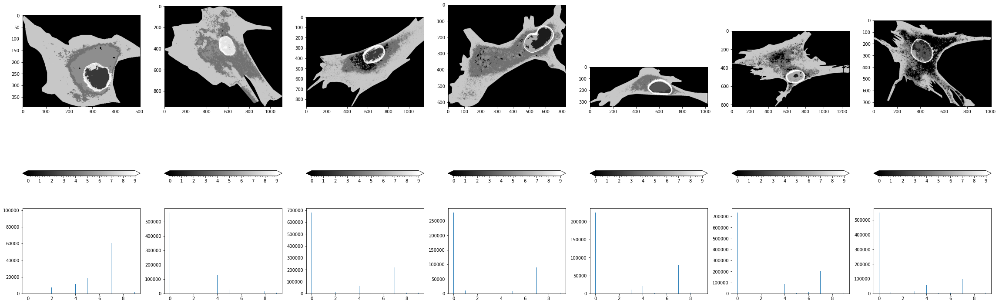

  0%|          | 0/7 [00:00<?, ?it/s]

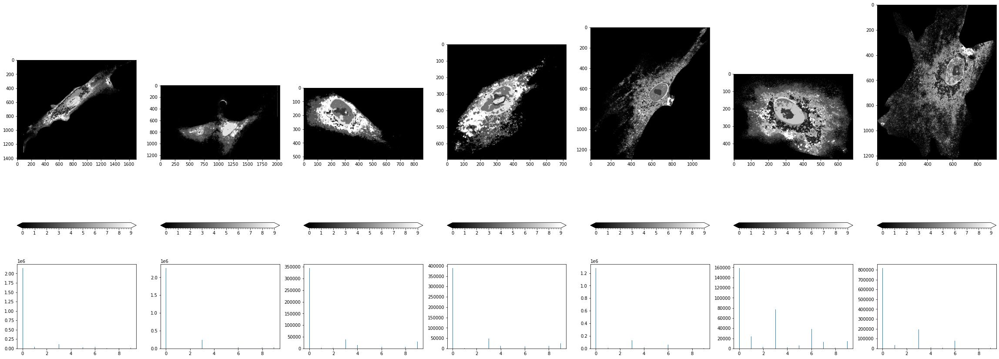

In [19]:
display_list_image(clustered_arrays_all_BM)
display_list_image(clustered_arrays_all_UC)

In [20]:
organelles_arrays_all_BM = [np.zeros((len(organnelle_names), ) + zoomed_image_list_BM[cell][0].shape) for cell in BM_indices]
df_selected_cell_organelles_all_BM = df_segm_pca_means_all_BM[['cell', 'index_i', 'index_j'] + organnelle_names]
df_selected_cell_organelles_array_all_BM = df_selected_cell_organelles_all_BM.to_numpy()

for line in trange(df_selected_cell_organelles_array_all_BM.shape[0]):
    cell = int(df_selected_cell_organelles_array_all_BM[line, 0])
    index_i = int(df_selected_cell_organelles_array_all_BM[line, 1])
    index_j = int(df_selected_cell_organelles_array_all_BM[line, 2])
    orga = df_selected_cell_organelles_array_all_BM[line, 3:]
    organelles_arrays_all_BM[cell][:, index_i, index_j] = orga

  0%|          | 0/1815074 [00:00<?, ?it/s]

In [21]:
organelles_arrays_all_UC = [np.zeros((len(organnelle_names), ) + zoomed_image_list_UC[cell][0].shape) for cell in UC_indices]
df_selected_cell_organelles_all_UC = df_segm_pca_means_all_UC[['cell', 'index_i', 'index_j'] + organnelle_names]
df_selected_cell_organelles_array_all_UC = df_selected_cell_organelles_all_UC.to_numpy()

for line in trange(df_selected_cell_organelles_array_all_UC.shape[0]):
    cell = int(df_selected_cell_organelles_array_all_UC[line, 0])
    index_i = int(df_selected_cell_organelles_array_all_UC[line, 1])
    index_j = int(df_selected_cell_organelles_array_all_UC[line, 2])
    orga = df_selected_cell_organelles_array_all_UC[line, 3:]
    organelles_arrays_all_UC[cell][:, index_i, index_j] = orga

  0%|          | 0/3027746 [00:00<?, ?it/s]

In [22]:
def group_marker_plot(image_temp, marker_group, channel_names, mask_temp):
    color_list_multiplier = [[1., 0., 0.], [0., 1., 0.], [0., 0., 1.]]
    
    image_display_temp = color.gray2rgb(image_temp[channel_names.index(marker_group[0])] * mask_temp)
    image_display_temp = color_list_multiplier[0] * image_display_temp
    image_display_temp = (image_display_temp - image_display_temp.min()) / image_display_temp.ptp()
    
    image_display_temp_2 = color.gray2rgb(image_temp[channel_names.index(marker_group[1])] * mask_temp)
    image_display_temp_2 = color_list_multiplier[2] * image_display_temp_2
    image_display_temp_2 = (image_display_temp_2 - image_display_temp_2.min())/ image_display_temp_2.ptp()
    
    return(image_display_temp + image_display_temp_2)

In [23]:
plt.cm.tab10(10)

(0.09019607843137255, 0.7450980392156863, 0.8117647058823529, 1.0)

### Clustering plots - BM

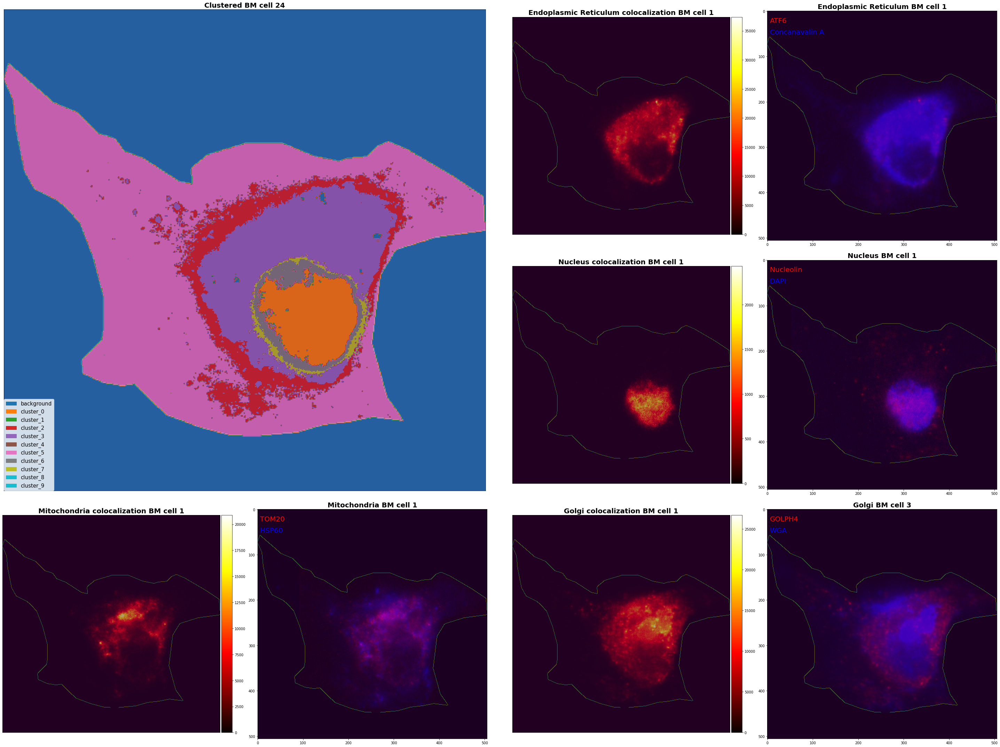

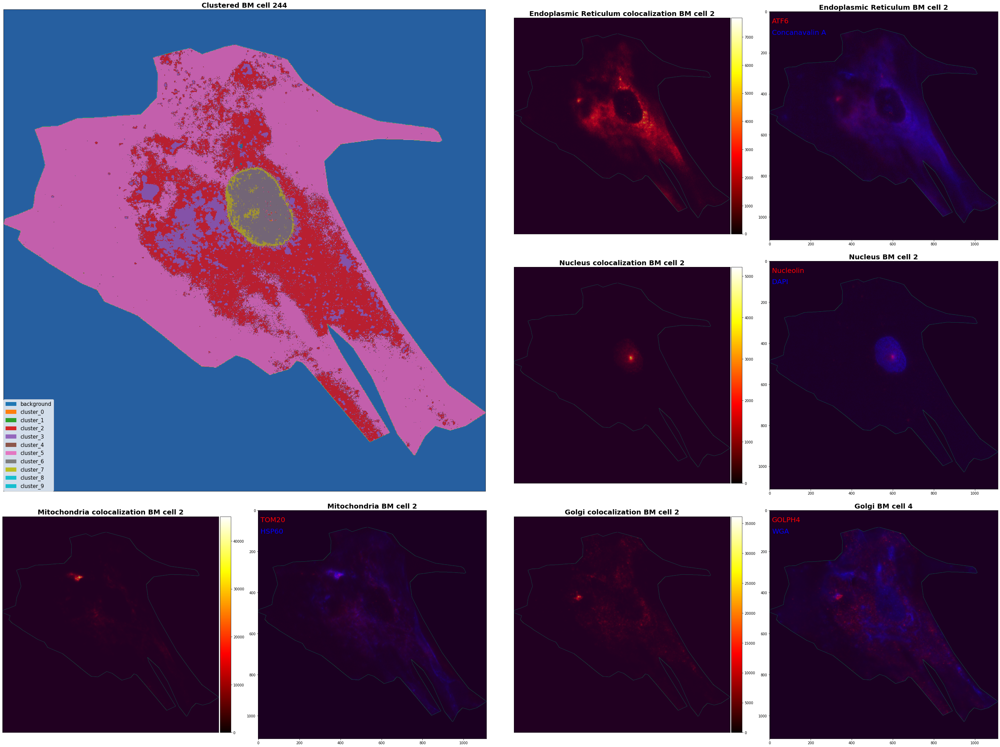

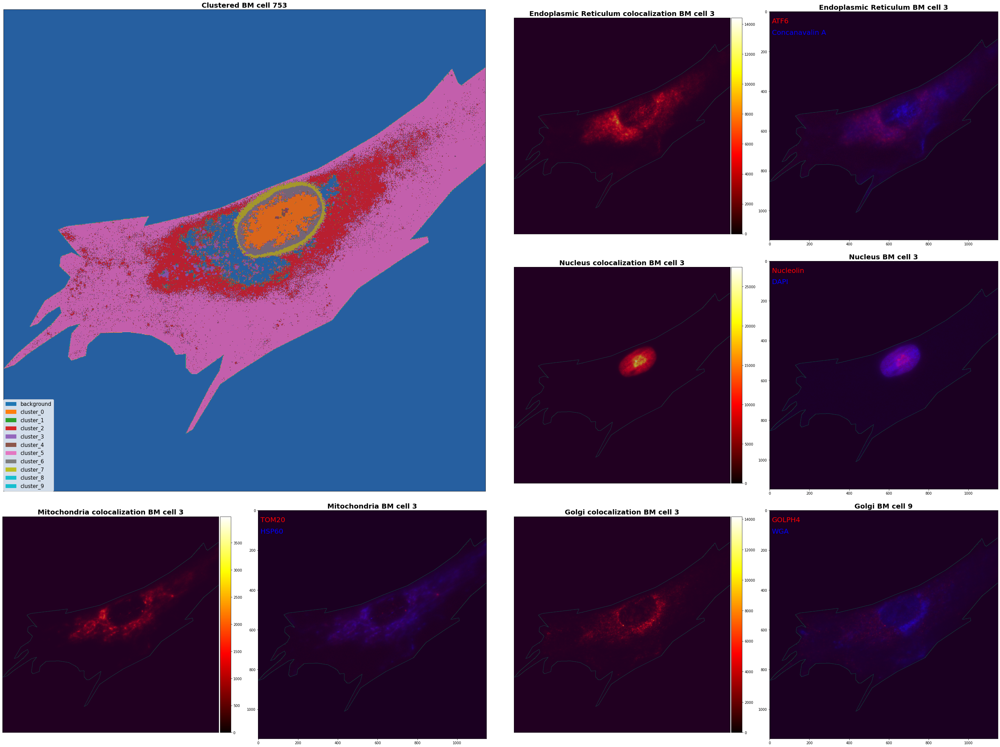

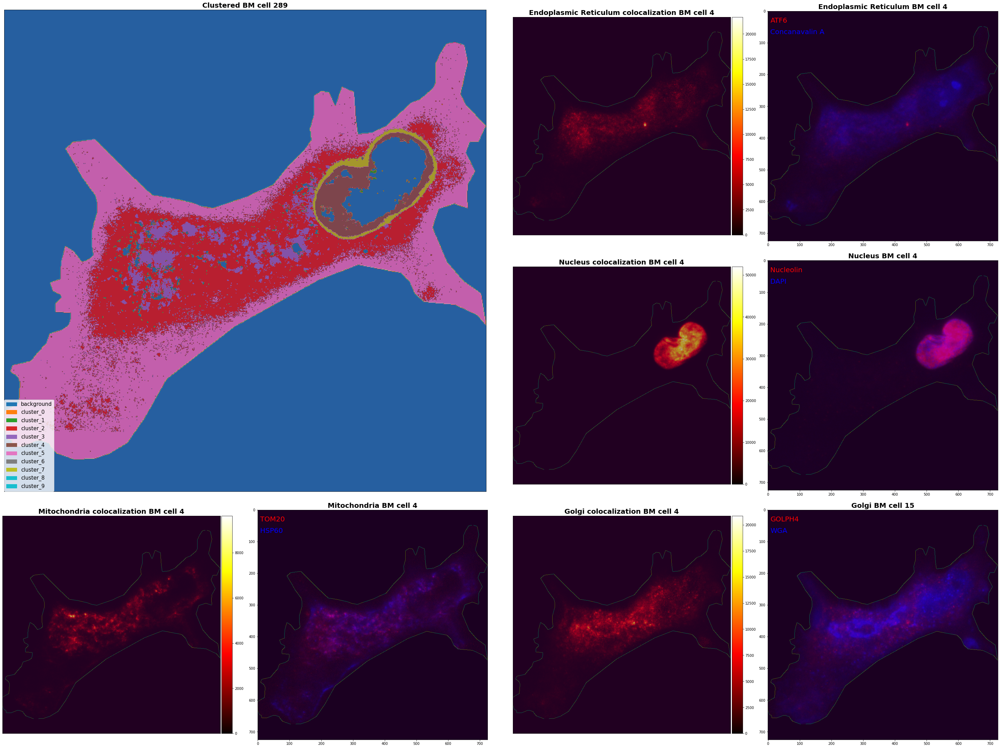

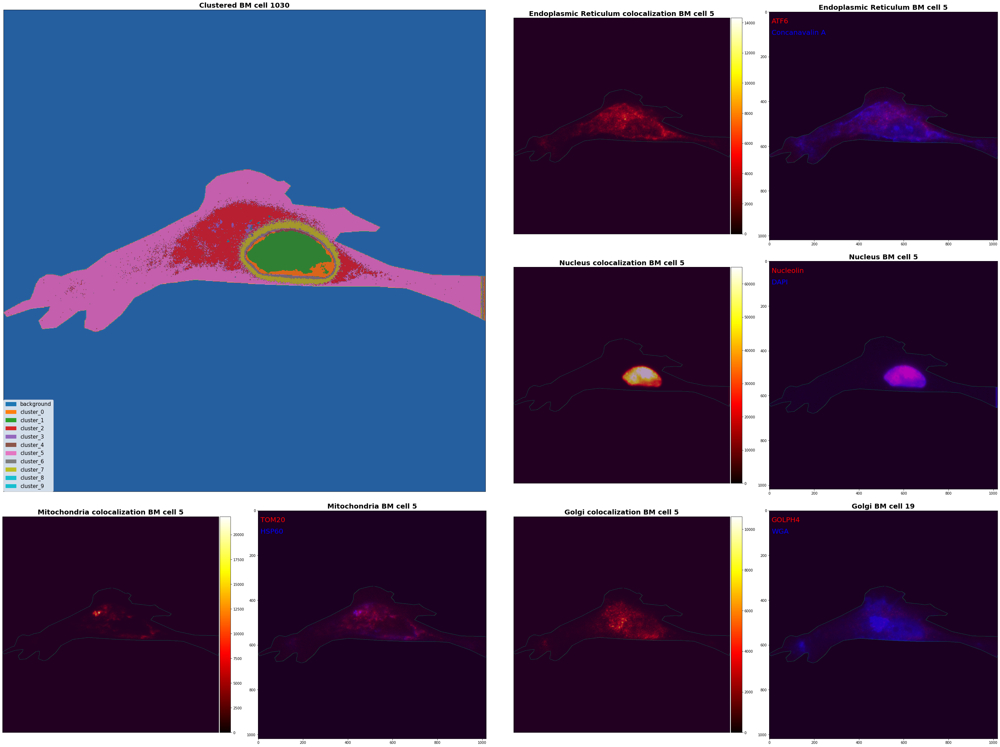

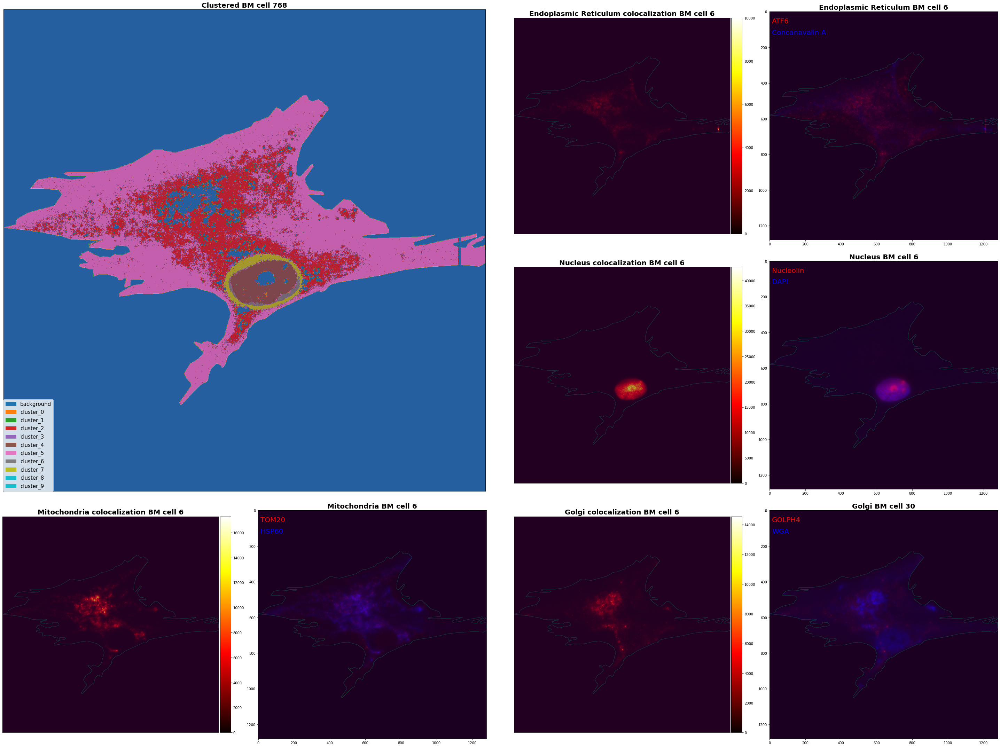

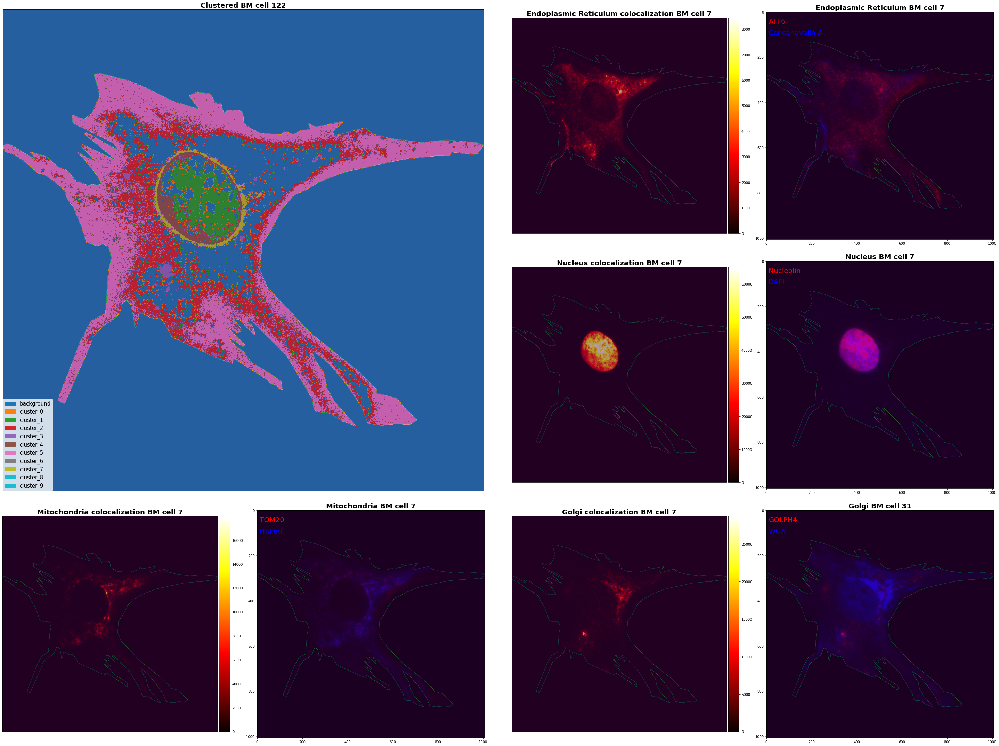

In [24]:
cluster_names = ['background'] + [f'cluster_{i}' for i in range(nb_cluster_all_BM + 1)]
channel_names_real = ['ATF6', '\u03B2 Tubulin', 'Concanavalin A', 'DAPI', 'GOLPH4', 'HSP60', 'Nucleolin', 'Phalloidin', 'Sortilin', 'TOM20', 'WGA']
channel_group = [["TOM20", "HSP60"], ["ATF6", "ConcanavalinA"], ["Nucleolin", "DAPI"], ["GOLPH4", "WGA"]]


channel_names_map = {}
for i in range(len(channel_names)):
    channel_names_map[channel_names[i]] = channel_names_real[i]
    
vals = np.linspace(0, 1, nb_cluster_all_BM+1)
my_cmap_row = plt.cm.tab10(vals)
patches = [
        mpatches.Patch(color=my_cmap_row[i], label=cluster_names[i]) #
        for i in range(nb_cluster_all_BM+1)
    ]
cmap1 = 'hot'

for ind in range(len(BM_indices)):
    m = BM_indices[ind]
    x, y, h, w = bounding_list_BM[m]
    max_size = max(h, w)
    mask_temp = zoomed_mask_list_BM[m]
    mask_temp_canny = cv2.Canny(mask_temp.copy(), 100, 200) / 255
    mask_temp_canny = np.pad(mask_temp_canny, ((ceil((max_size-w)/2), floor((max_size-w)/2)), (ceil((max_size-h)/2), floor((max_size-h)/2))), 'constant', constant_values=0)
    mask_temp = np.pad(mask_temp, ((ceil((max_size-w)/2), floor((max_size-w)/2)), (ceil((max_size-h)/2), floor((max_size-h)/2))), 'constant', constant_values=0)
    image_temp = np.pad(zoomed_image_list_BM[m], ((0, 0), (ceil((max_size-w)/2), floor((max_size-w)/2)), (ceil((max_size-h)/2), floor((max_size-h)/2))), 'constant', constant_values=0)
    
    clustered_array_temp = clustered_arrays_all_BM[ind]
    clustered_array_temp = np.pad(clustered_array_temp, ((ceil((max_size-w)/2), floor((max_size-w)/2)), (ceil((max_size-h)/2), floor((max_size-h)/2))), 'constant', constant_values=0)
    
    fig = plt.figure(figsize=(40, 30))
    gs = gridspec.GridSpec(3, 4)
    ax1 = plt.subplot(gs[0:2, 0:2])
    ax1.imshow(clustered_array_temp, cmap='tab10', vmin=0, vmax=nb_cluster_all_BM+1)
    ax1.imshow(mask_temp_canny, alpha=0.2)
    ax1.set_title(f"Clustered BM cell {x+1}", fontsize=20, fontweight ="bold")
    ax1.tick_params(bottom=False, labelbottom=False,
                   left=False, labelleft=False)
    ax1.legend(
        handles=patches,
        bbox_to_anchor=(0, 0),
        loc="lower left",
        borderaxespad=0.0,
        fontsize=15,
    )
    
    organelles_array_temp = organelles_arrays_all_BM[ind]
    organelles_array_temp = np.pad(organelles_array_temp, ((0, 0), (ceil((max_size-w)/2), floor((max_size-w)/2)), (ceil((max_size-h)/2), floor((max_size-h)/2))), 'constant', constant_values=0)
    
    
    ax2 = plt.subplot(gs[2, 0])
    pos = ax2.imshow(organelles_array_temp[0], cmap=cmap1, vmin=0, vmax=organelles_array_temp[0].max())
    ax2.imshow(mask_temp_canny, alpha=0.4)
    ax2.set_title(f"{organnelle_names_plot[0]} colocalization BM cell {ind+1}", fontsize=20, fontweight ="bold")
    ax2.tick_params(bottom=False, labelbottom=False,
                   left=False, labelleft=False)
    divider = make_axes_locatable(ax2)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(pos, cax=cax)

    ax2_2 = plt.subplot(gs[2, 1])
    marker_group = channel_group[0]
    image_display_temp = group_marker_plot(image_temp, marker_group, channel_names, mask_temp)
    ax2_2.imshow(image_display_temp, alpha=1., vmin=0.8)
    ax2_2.imshow(mask_temp_canny, alpha=0.4)
    ax2_2.text(s=channel_names_map[marker_group[0]], x = 0.01*max_size, y=0.05*max_size, color='red', fontsize=20)
    ax2_2.text(s=channel_names_map[marker_group[1]], x = 0.01*max_size, y=0.1*max_size, color='blue', fontsize=20)      
    ax2_2.set_title(f"{organnelle_names_plot[0]} BM cell {ind+1}", fontsize=20, fontweight ="bold")
    

    ax3 = plt.subplot(gs[0, 2])
    pos = ax3.imshow(organelles_array_temp[1], cmap=cmap1, vmin=0, vmax=organelles_array_temp[1].max())
    ax3.imshow(mask_temp_canny, alpha=0.4)
    ax3.set_title(f"{organnelle_names_plot[1]} colocalization BM cell {ind+1}", fontsize=20, fontweight ="bold")
    ax3.tick_params(bottom=False, labelbottom=False,
                   left=False, labelleft=False)
    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(pos, cax=cax)
    
    ax3_2 = plt.subplot(gs[0, 3])
    marker_group = channel_group[1]
    image_display_temp = group_marker_plot(image_temp, marker_group, channel_names, mask_temp)
    ax3_2.imshow(image_display_temp, alpha=1., vmin=0.8)
    ax3_2.imshow(mask_temp_canny, alpha=0.4)
    ax3_2.text(s=channel_names_map[marker_group[0]], x = 0.01*max_size, y=0.05*max_size, color='red', fontsize=20)
    ax3_2.text(s=channel_names_map[marker_group[1]], x = 0.01*max_size, y=0.1*max_size, color='blue', fontsize=20)      
    ax3_2.set_title(f"{organnelle_names_plot[1]} BM cell {ind+1}", fontsize=20, fontweight ="bold")
    
    
    ax4 = plt.subplot(gs[1, 2])
    pos = ax4.imshow(organelles_array_temp[2], cmap=cmap1, vmin=0, vmax=organelles_array_temp[2].max())
    ax4.imshow(mask_temp_canny, alpha=0.4)
    ax4.set_title(f"{organnelle_names_plot[2]} colocalization BM cell {ind+1}", fontsize=20, fontweight ="bold")
    ax4.tick_params(bottom=False, labelbottom=False,
                   left=False, labelleft=False)
    divider = make_axes_locatable(ax4)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(pos, cax=cax)
    
    ax4_2 = plt.subplot(gs[1, 3])
    marker_group = channel_group[2]
    image_display_temp = group_marker_plot(image_temp, marker_group, channel_names, mask_temp)
    ax4_2.imshow(image_display_temp, alpha=1., vmin=0.8)
    ax4_2.imshow(mask_temp_canny, alpha=0.4)
    ax4_2.text(s=channel_names_map[marker_group[0]], x = 0.01*max_size, y=0.05*max_size, color='red', fontsize=20)
    ax4_2.text(s=channel_names_map[marker_group[1]], x = 0.01*max_size, y=0.1*max_size, color='blue', fontsize=20)      
    ax4_2.set_title(f"{organnelle_names_plot[2]} BM cell {ind+1}", fontsize=20, fontweight ="bold")
    
    
    ax5 = plt.subplot(gs[2, 2])
    pos = ax5.imshow(organelles_array_temp[3], cmap=cmap1, vmin=0, vmax=organelles_array_temp[3].max())
    ax5.imshow(mask_temp_canny, alpha=0.4)
    ax5.set_title(f"{organnelle_names_plot[3]} colocalization BM cell {ind+1}", fontsize=20, fontweight ="bold")
    ax5.tick_params(bottom=False, labelbottom=False,
                   left=False, labelleft=False)
    divider = make_axes_locatable(ax5)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(pos, cax=cax)
    
    ax5_2 = plt.subplot(gs[2, 3])
    marker_group = channel_group[3]
    image_display_temp = group_marker_plot(image_temp, marker_group, channel_names, mask_temp)
    ax5_2.imshow(image_display_temp, alpha=1., vmin=0.8)
    ax5_2.imshow(mask_temp_canny, alpha=0.4)
    ax5_2.text(s=channel_names_map[marker_group[0]], x = 0.01*max_size, y=0.05*max_size, color='red', fontsize=20)
    ax5_2.text(s=channel_names_map[marker_group[1]], x = 0.01*max_size, y=0.1*max_size, color='blue', fontsize=20)      
    ax5_2.set_title(f"{organnelle_names_plot[3]} BM cell {m+1}", fontsize=20, fontweight ="bold")
    
    
    plt.tight_layout()

    image_path_png = save_path+"/clustered_BM_cell_"+str(ind+1)+".png"
    plt.savefig(image_path_png, edgecolor='none', bbox_inches="tight")
    fig.set_facecolor("white")
    plt.show()

In [25]:
df_cluster_BM = pd.DataFrame(df_list_BM, columns = ["Cell_num","X","Y","Cluster"])
df_cluster_BM

,Cell_num,X,Y,Cluster
0,0,0,5,7
1,0,1,5,7
2,0,1,6,7
3,0,2,4,7
4,0,2,5,7
...,...,...,...,...
1815069,6,735,796,7
1815070,6,736,736,7
1815071,6,736,737,7
1815072,6,736,738,7


In [26]:
def create_HM(
    df_per_label, my_cmap, row_colors, scale_name, cellSizePixels=20, **kwargs
):
    # Calulate the figure size, this gets us close, but not quite to the right place
    dpi = matplotlib.rcParams["figure.dpi"]
    marginWidth = (
        matplotlib.rcParams["figure.subplot.right"]
        - matplotlib.rcParams["figure.subplot.left"]
    )
    marginHeight = (
        matplotlib.rcParams["figure.subplot.top"]
        - matplotlib.rcParams["figure.subplot.bottom"]
    )
    Ny, Nx = df_per_label.shape
    figWidth = (Nx * cellSizePixels / dpi) / marginWidth
    figHeigh = (Ny * cellSizePixels / dpi) / marginHeight

    ax = sns.clustermap(
        df_per_label,
        cbar_kws={"fraction": 0.01},
        cmap=my_cmap,
        linewidth=0.1,
        col_cluster=False,
        row_colors=[row_colors],
        dendrogram_ratio=(0.1, 0.0),
        figsize=(figWidth, figHeigh),
        **kwargs,
    )
    ax.ax_heatmap.set_yticklabels(ax.ax_heatmap.get_yticklabels(), rotation=0)
    ax.ax_heatmap.set_xticklabels(
        ax.ax_heatmap.get_xticklabels(), rotation=45, horizontalalignment="right"
    )
    ax.ax_heatmap.set_xlabel("Marker")
    ax.ax_heatmap.set_ylabel("Cluster")

    # calculate the size of the heatmap axes
    axWidth = (Nx * cellSizePixels) / (figWidth * dpi)
    axHeight = (Ny * cellSizePixels) / (figHeigh * dpi)

    # resize heatmap
    ax_heatmap_orig_pos = ax.ax_heatmap.get_position()
    ax.ax_heatmap.set_position(
        [ax_heatmap_orig_pos.x0, ax_heatmap_orig_pos.y0, axWidth, axHeight]
    )

    # resize dendrograms to match
    ax_row_orig_pos = ax.ax_row_dendrogram.get_position()
    ax.ax_row_dendrogram.set_position(
        [ax_row_orig_pos.x0, ax_row_orig_pos.y0, ax_row_orig_pos.width, axHeight]
    )
    ax_row_orig_pos = ax.ax_row_colors.get_position()
    ax.ax_row_colors.set_position(
        [ax_row_orig_pos.x0, ax_row_orig_pos.y0, ax_row_orig_pos.width, axHeight]
    )
    
    pos = ax.ax_heatmap.get_position()
    cbar_size=0.2
    ax.ax_cbar.set_position((1.05, pos.y0, .03, cbar_size))
    
    # Change colorbar label position
    cbar = ax.ax_heatmap.collections[0].colorbar
    cbar.set_label(scale_name, fontsize=12)

    for _, spine in ax.ax_heatmap.spines.items():
        spine.set_visible(True)
        spine.set_linewidth(3)

In [27]:
df_images_all_BM.head()

,ATF6,BetaTubulin,ConcanavalinA,DAPI,GOLPH4,HSP60,Nucleolin,Phalloidin,Sortilin,TOM20,WGA,cell,index_i,index_j,mitochondria,endoplasmic_reticulum,nucleus,golgi,plasma_membrane,CellType
5,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,4.509696,0.0,0.0,3.598631,0,0.0,5.0,0.0,0.0,0.0,0.0,3.598631,BM
511,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,2.529918,0.0,0.0,3.308033,0,1.0,5.0,0.0,0.0,0.0,0.0,3.308033,BM
512,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,3.024862,0.0,0.0,2.494359,0,1.0,6.0,0.0,0.0,0.0,0.0,2.494359,BM
1016,0.0,0.0,0.0,0.0,0.0,0.560966,0.0,6.118265,0.0,0.0,5.051620,0,2.0,4.0,0.0,0.0,0.0,0.0,5.051620,BM
1017,0.0,0.0,0.0,0.0,0.0,0.085074,0.0,4.633432,0.0,0.0,4.819141,0,2.0,5.0,0.0,0.0,0.0,0.0,4.819141,BM


In [28]:
# Get dataframe per cluster
df_pixels_BM = df_images_all_BM.copy()
df_pixels_BM['Cell_num'] = df_pixels_BM['cell']
df_pixels_BM['X'] = df_pixels_BM['index_i']
df_pixels_BM['Y'] = df_pixels_BM['index_j']
df_pixels_updated_BM = result = pd.merge(df_pixels_BM, df_cluster_BM, on=["X", "Y","Cell_num"]) 
df_per_label_BM = df_pixels_updated_BM.groupby("Cluster").mean()
df_per_label_BM = df_per_label_BM[channel_cluster]
df_per_label_BM

,ATF6,DAPI,GOLPH4,Nucleolin,TOM20
Cluster,,,,,
0,58.230910,16.210209,15.898966,5.247673,18.862431
1,15.746855,141.796420,7.655094,226.987386,10.880618
2,16.248025,222.691216,15.654701,41.074003,14.343508
3,17.842624,239.442432,6.505748,200.119837,11.755744
4,19.530853,11.859779,16.423701,2.560716,15.611095
5,30.594462,15.049804,49.499036,1.742017,29.653203
6,17.402964,128.953421,7.589591,122.838503,11.405513
7,6.589946,10.047907,5.728788,1.013416,5.925784
8,14.035134,129.987605,12.367415,15.747812,12.206821


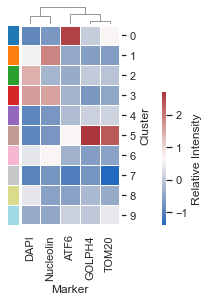

In [29]:
import scipy.cluster.hierarchy as sch
import matplotlib

# Calulate the figure size, this gets us close, but not quite to the right place
my_cmap = "vlag"
scale_name = "Relative Intensity"

# Get linkage
d = sch.distance.pdist(df_per_label_BM, metric='cosine')
L = sch.linkage(d, method="average")

# Get colormap
vals = np.linspace(0, 1, len(df_per_label_BM))
my_cmap_row = plt.cm.tab20(vals)

# Clustermap and umap
labels = df_per_label_BM.index.to_list()
my_cmap_dict = dict(zip(labels, my_cmap_row))
row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)
cellSizePixels = 20 #10

dpi = matplotlib.rcParams['figure.dpi']
marginWidth = matplotlib.rcParams['figure.subplot.right']-matplotlib.rcParams['figure.subplot.left']
marginHeight = matplotlib.rcParams['figure.subplot.top']-matplotlib.rcParams['figure.subplot.bottom']
Ny,Nx = df_per_label_BM.shape
figWidth = (Nx*cellSizePixels/dpi)/marginWidth
figHeigh = (Ny*cellSizePixels/dpi)/marginHeight

sns.set(font_scale=1)
ax = sns.clustermap(df_per_label_BM.reset_index(drop=True),
                    cmap=my_cmap,
                    z_score=1,
                    linewidth=0.5,
                    row_cluster=False,
                    row_colors=[row_colors],
                    dendrogram_ratio=(0.0, 0.1),
                    figsize=(figWidth, figHeigh),
                    colors_ratio=0.15
                    )
ax.ax_heatmap.set_yticklabels(
    ax.ax_heatmap.get_yticklabels(), rotation=0)
ax.ax_heatmap.set_xticklabels(
    ax.ax_heatmap.get_xticklabels(), rotation=90)
ax.ax_heatmap.set_xlabel('Marker')
ax.ax_heatmap.set_ylabel('Cluster')

# calculate the size of the heatmap axes
axWidth = (Nx*cellSizePixels)/(figWidth*dpi)
axHeight = (Ny*cellSizePixels)/(figHeigh*dpi)

# resize heatmap
ax_heatmap_orig_pos = ax.ax_heatmap.get_position()
ax.ax_heatmap.set_position([ax_heatmap_orig_pos.x0, ax_heatmap_orig_pos.y0, 
                              axWidth, axHeight])

# resize dendrograms to match
ax_col_orig_pos = ax.ax_col_dendrogram.get_position()
ax.ax_col_dendrogram.set_position([ax_col_orig_pos.x0, ax_heatmap_orig_pos.y0+axHeight,
                                     axWidth, ax_col_orig_pos.height])
ax_row_orig_pos = ax.ax_row_colors.get_position()
ax.ax_row_colors.set_position([ax_row_orig_pos.x0, ax_row_orig_pos.y0, 
                                     ax_row_orig_pos.width, axHeight])

pos = ax.ax_heatmap.get_position()
cbar_size=0.5
ax.ax_cbar.set_position((1.3, pos.y0, .03, cbar_size))

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name, fontsize=12)

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)

image_path_png = save_path+"/clustered_BM_cell_heatmap1.png"

ax.savefig(image_path_png, edgecolor='none', bbox_inches="tight")

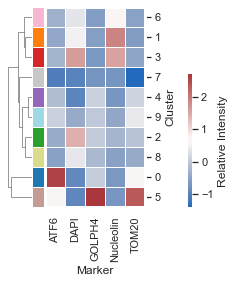

In [30]:
# Clustermap and umap
labels = df_per_label_BM.index.to_list()
my_cmap_dict = dict(zip(labels, my_cmap_row))
row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)
cellSizePixels = 20 

dpi = matplotlib.rcParams['figure.dpi']
marginWidth = matplotlib.rcParams['figure.subplot.right']-matplotlib.rcParams['figure.subplot.left']
marginHeight = matplotlib.rcParams['figure.subplot.top']-matplotlib.rcParams['figure.subplot.bottom']
Ny,Nx = df_per_label_BM.shape
figWidth = (Nx*cellSizePixels/dpi)/marginWidth
figHeigh = (Ny*cellSizePixels/dpi)/marginHeight
sns.set(font_scale=1)
ax = sns.clustermap(df_per_label_BM.reset_index(drop=True),
                    cmap=my_cmap,
                    linewidth=0.5,
                    z_score=1,
                    row_cluster=True,
                    col_cluster=False,
                    row_colors=[row_colors],
                    dendrogram_ratio=(0.3, 0.0),
                    figsize=(figWidth, figHeigh),
                    colors_ratio=0.15,
                    xticklabels=True, yticklabels=True
                    )
ax.ax_heatmap.set_yticklabels(
    ax.ax_heatmap.get_yticklabels(), rotation=0)
ax.ax_heatmap.set_xticklabels(
    ax.ax_heatmap.get_xticklabels(), rotation=90)
ax.ax_heatmap.set_xlabel('Marker')
ax.ax_heatmap.set_ylabel('Cluster')

# calculate the size of the heatmap axes
axWidth = (Nx*cellSizePixels)/(figWidth*dpi)
axHeight = (Ny*cellSizePixels)/(figHeigh*dpi)

# resize heatmap
ax_heatmap_orig_pos = ax.ax_heatmap.get_position()
ax.ax_heatmap.set_position([ax_heatmap_orig_pos.x0, ax_heatmap_orig_pos.y0, 
                              axWidth, axHeight])

# resize dendrograms to match
ax_row_orig_pos = ax.ax_row_dendrogram.get_position()
ax.ax_row_dendrogram.set_position([ax_row_orig_pos.x0, ax_heatmap_orig_pos.y0,
                                     ax_row_orig_pos.width, axHeight])
ax_row_orig_pos = ax.ax_row_colors.get_position()
ax.ax_row_colors.set_position([ax_row_orig_pos.x0, ax_row_orig_pos.y0, 
                                     ax_row_orig_pos.width, axHeight])

pos = ax.ax_heatmap.get_position()
cbar_size=0.5
ax.ax_cbar.set_position((1.5, pos.y0, .03, cbar_size))

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name, fontsize=12)

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)

image_path_png = save_path+"/clustered_BM_cell_heatmap2.png"

ax.savefig(image_path_png, edgecolor='none', bbox_inches="tight")

### Clustering plots - UC

  0%|          | 0/7 [00:00<?, ?it/s]

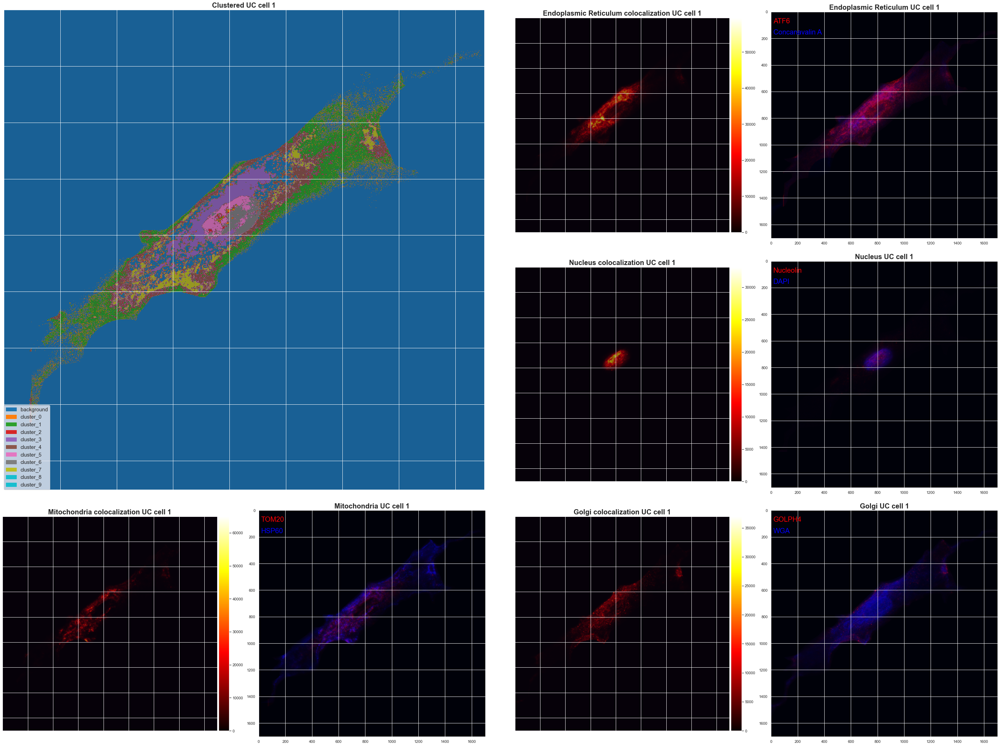

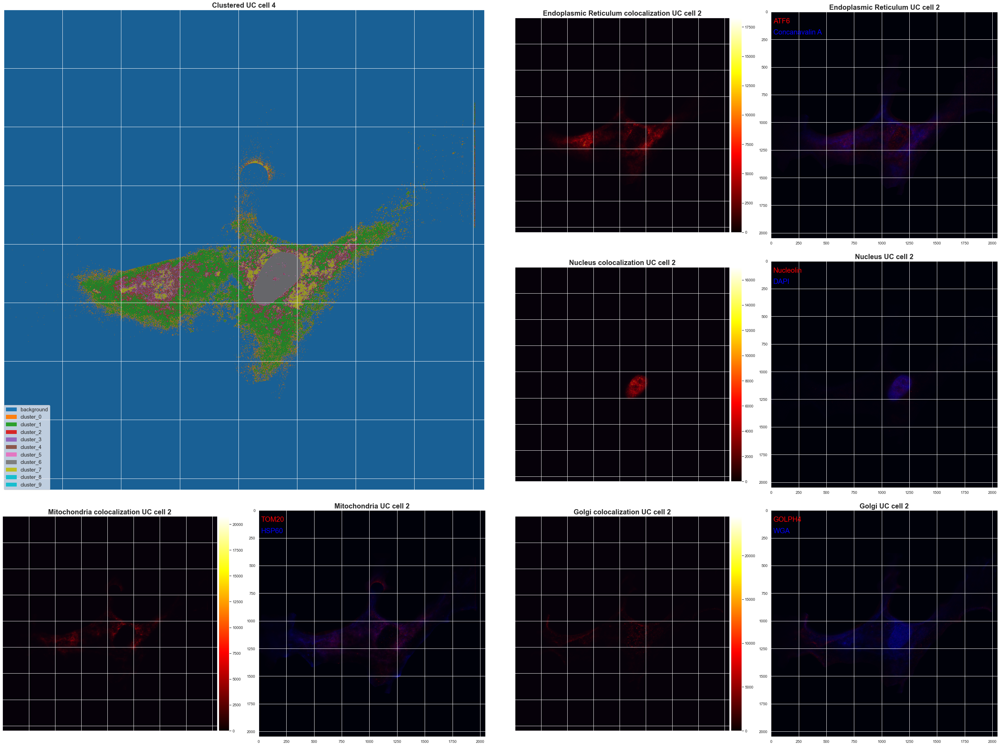

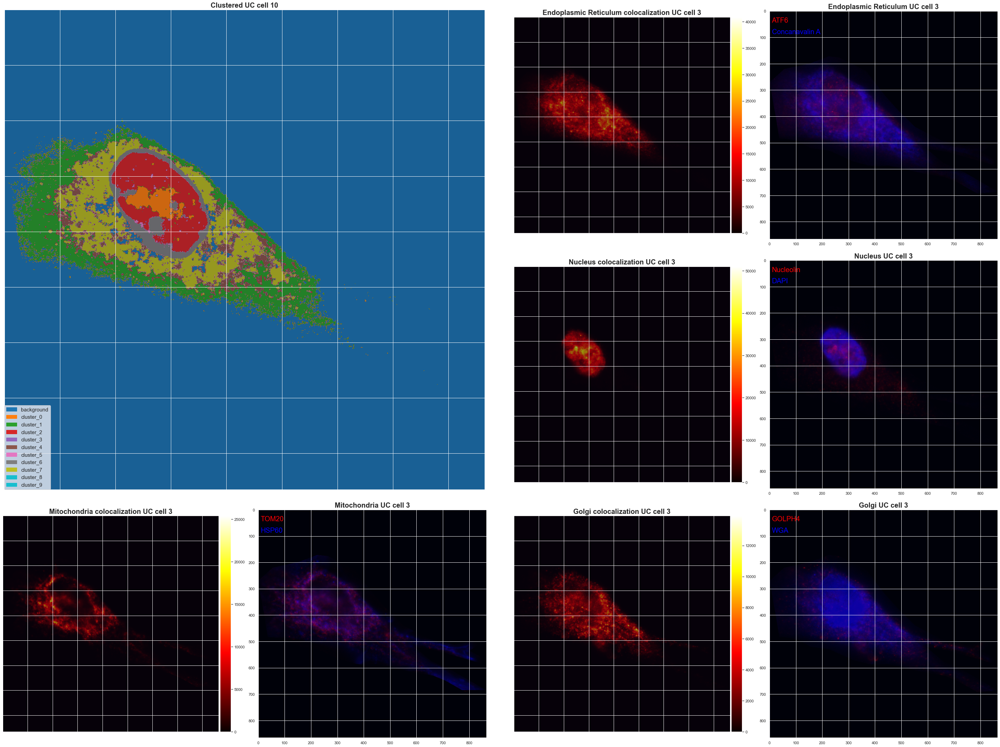

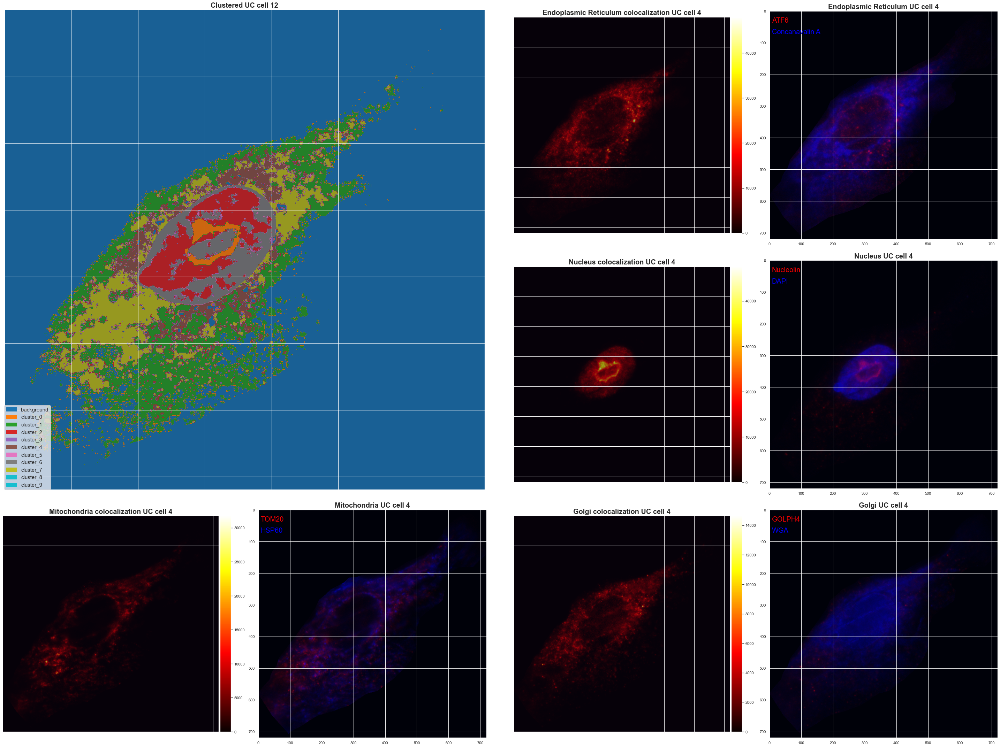

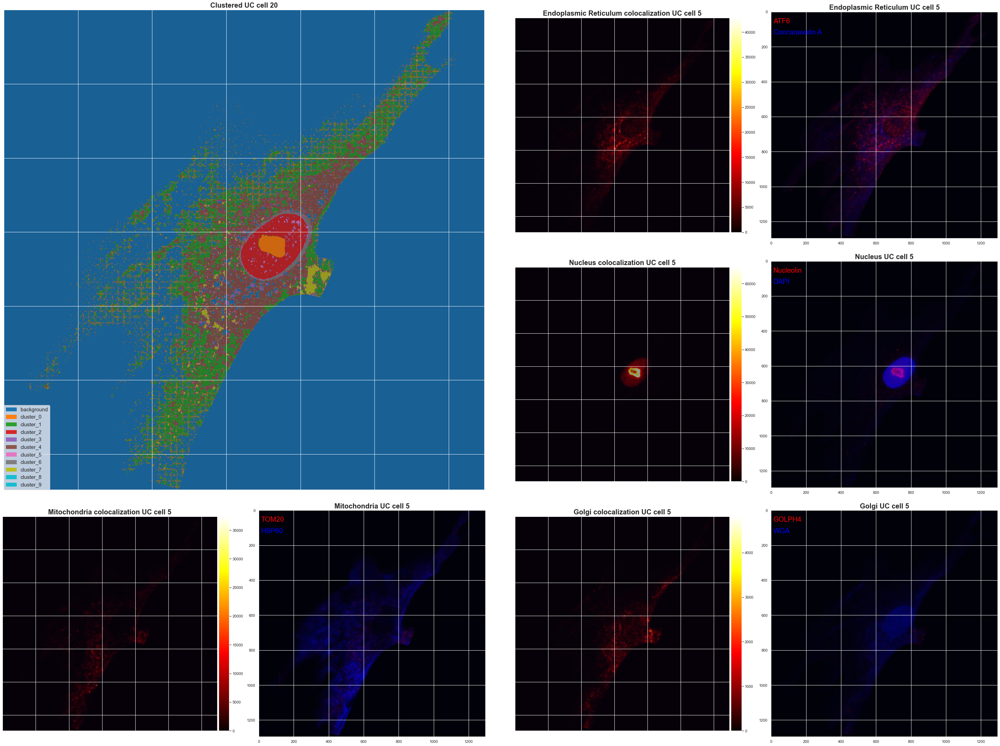

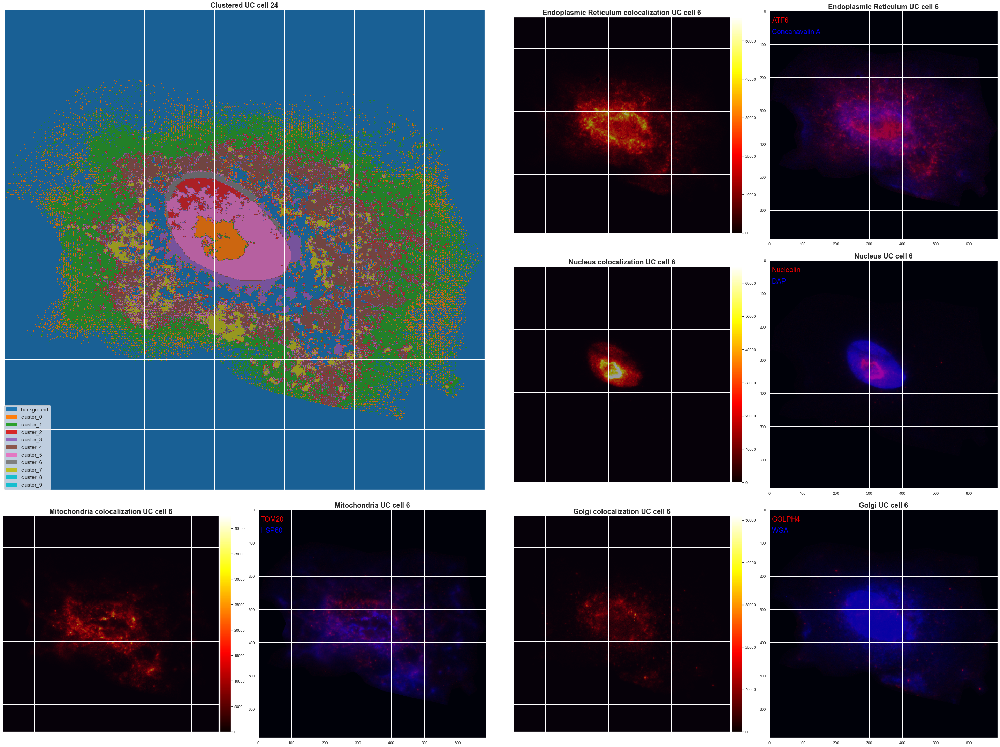

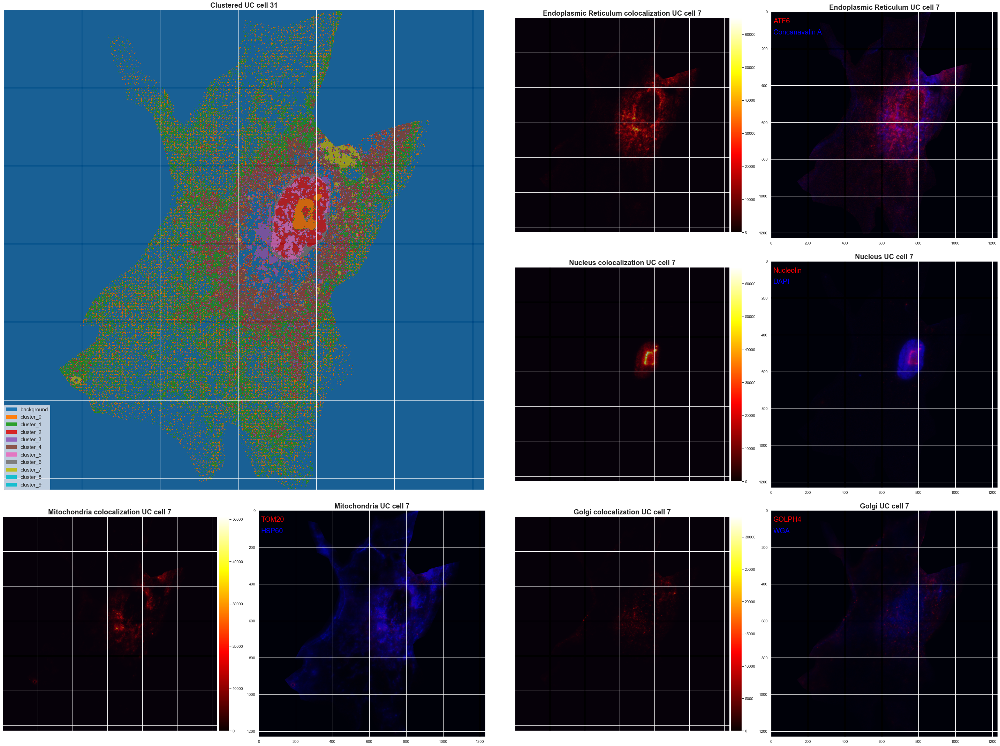

In [31]:
cluster_names = ['background'] + [f'cluster_{i}' for i in range(nb_cluster_all_UC)]

vals = np.linspace(0, 1, nb_cluster_all_UC+1)
my_cmap_row = plt.cm.tab10(vals)
cmap1 = 'hot'
patches = [
        mpatches.Patch(color=my_cmap_row[i], label=cluster_names[i])
        for i in range(nb_cluster_all_UC+1)
    ]

for ind in trange(len(UC_indices)):
    m = UC_indices[ind]
    x, y, h, w = bounding_list_UC[m]
    max_size = max(h, w)
    mask_temp = (1 - zoomed_mask_list_UC[m].astype(np.uint8)) * 255
    mask_temp_canny = cv2.Canny(mask_temp.copy(), 100, 200) / 255
    mask_temp_canny = np.pad(mask_temp_canny, ((ceil((max_size-w)/2), floor((max_size-w)/2)), (ceil((max_size-h)/2), floor((max_size-h)/2))), 'constant', constant_values=0)
    mask_temp = np.pad(mask_temp, ((ceil((max_size-w)/2), floor((max_size-w)/2)), (ceil((max_size-h)/2), floor((max_size-h)/2))), 'constant', constant_values=0)
    image_temp = np.pad(zoomed_image_list_UC[m], ((0, 0), (ceil((max_size-w)/2), floor((max_size-w)/2)), (ceil((max_size-h)/2), floor((max_size-h)/2))), 'constant', constant_values=0)
    
    clustered_array_temp = clustered_arrays_all_UC[ind]
    clustered_array_temp = np.pad(clustered_array_temp, ((ceil((max_size-w)/2), floor((max_size-w)/2)), (ceil((max_size-h)/2), floor((max_size-h)/2))), 'constant', constant_values=0)
    
    fig = plt.figure(figsize=(40, 30))
    gs = gridspec.GridSpec(3, 4)
    ax1 = plt.subplot(gs[0:2, 0:2])
    ax1.imshow(clustered_array_temp, cmap='tab10', vmin=0, vmax=nb_cluster_all_UC+1)
    ax1.imshow(mask_temp_canny, alpha=0.2)
    ax1.set_title(f"Clustered UC cell {m+1}", fontsize=20, fontweight ="bold")
    ax1.tick_params(bottom=False, labelbottom=False,
                   left=False, labelleft=False)
    ax1.legend(
        handles=patches,
        bbox_to_anchor=(0, 0),
        loc="lower left",
        borderaxespad=0.0,
        fontsize=15,
    )
    
    organelles_array_temp = organelles_arrays_all_UC[ind]
    organelles_array_temp = np.pad(organelles_array_temp, ((0, 0), (ceil((max_size-w)/2), floor((max_size-w)/2)), (ceil((max_size-h)/2), floor((max_size-h)/2))), 'constant', constant_values=0)
    
    
    ax2 = plt.subplot(gs[2, 0])
    pos = ax2.imshow(organelles_array_temp[0], cmap=cmap1)
    ax2.imshow(mask_temp_canny, alpha=0.4)
    ax2.set_title(f"{organnelle_names_plot[0]} colocalization UC cell {ind+1}", fontsize=20, fontweight ="bold")
    ax2.tick_params(bottom=False, labelbottom=False,
                   left=False, labelleft=False)
    divider = make_axes_locatable(ax2)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(pos, cax=cax)

    ax2_2 = plt.subplot(gs[2, 1])
    marker_group = channel_group[0]
    image_display_temp = group_marker_plot(image_temp, marker_group, channel_names, mask_temp)
    ax2_2.imshow(image_display_temp, alpha=1., vmin=0.8)
    ax2_2.imshow(mask_temp_canny, alpha=0.4)
    ax2_2.text(s=channel_names_map[marker_group[0]], x = 0.01*max_size, y=0.05*max_size, color='red', fontsize=20)
    ax2_2.text(s=channel_names_map[marker_group[1]], x = 0.01*max_size, y=0.1*max_size, color='blue', fontsize=20)      
    ax2_2.set_title(f"{organnelle_names_plot[0]} UC cell {ind+1}", fontsize=20, fontweight ="bold")
    

    ax3 = plt.subplot(gs[0, 2])
    pos = ax3.imshow(organelles_array_temp[1], cmap=cmap1)
    ax3.imshow(mask_temp_canny, alpha=0.4)
    ax3.set_title(f"{organnelle_names_plot[1]} colocalization UC cell {ind+1}", fontsize=20, fontweight ="bold")
    ax3.tick_params(bottom=False, labelbottom=False,
                   left=False, labelleft=False)
    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(pos, cax=cax)
    
    ax3_2 = plt.subplot(gs[0, 3])
    marker_group = channel_group[1]
    image_display_temp = group_marker_plot(image_temp, marker_group, channel_names, mask_temp)
    ax3_2.imshow(image_display_temp, alpha=1., vmin=0.8)
    ax3_2.imshow(mask_temp_canny, alpha=0.4)
    ax3_2.text(s=channel_names_map[marker_group[0]], x = 0.01*max_size, y=0.05*max_size, color='red', fontsize=20)
    ax3_2.text(s=channel_names_map[marker_group[1]], x = 0.01*max_size, y=0.1*max_size, color='blue', fontsize=20)      
    ax3_2.set_title(f"{organnelle_names_plot[1]} UC cell {ind+1}", fontsize=20, fontweight ="bold")
    
    
    ax4 = plt.subplot(gs[1, 2])
    pos = ax4.imshow(organelles_array_temp[2], cmap=cmap1)
    ax4.imshow(mask_temp_canny, alpha=0.4)
    ax4.set_title(f"{organnelle_names_plot[2]} colocalization UC cell {ind+1}", fontsize=20, fontweight ="bold")
    ax4.tick_params(bottom=False, labelbottom=False,
                   left=False, labelleft=False)
    divider = make_axes_locatable(ax4)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(pos, cax=cax)
    
    ax4_2 = plt.subplot(gs[1, 3])
    marker_group = channel_group[2]
    image_display_temp = group_marker_plot(image_temp, marker_group, channel_names, mask_temp)
    ax4_2.imshow(image_display_temp, alpha=1., vmin=0.8)
    ax4_2.imshow(mask_temp_canny, alpha=0.4)
    ax4_2.text(s=channel_names_map[marker_group[0]], x = 0.01*max_size, y=0.05*max_size, color='red', fontsize=20)
    ax4_2.text(s=channel_names_map[marker_group[1]], x = 0.01*max_size, y=0.1*max_size, color='blue', fontsize=20)      
    ax4_2.set_title(f"{organnelle_names_plot[2]} UC cell {ind+1}", fontsize=20, fontweight ="bold")
    
    
    ax5 = plt.subplot(gs[2, 2])
    pos = ax5.imshow(organelles_array_temp[3], cmap=cmap1)
    ax5.imshow(mask_temp_canny, alpha=0.4)
    ax5.set_title(f"{organnelle_names_plot[3]} colocalization UC cell {ind+1}", fontsize=20, fontweight ="bold")
    ax5.tick_params(bottom=False, labelbottom=False,
                   left=False, labelleft=False)
    divider = make_axes_locatable(ax5)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(pos, cax=cax)
    
    ax5_2 = plt.subplot(gs[2, 3])
    marker_group = channel_group[3]
    image_display_temp = group_marker_plot(image_temp, marker_group, channel_names, mask_temp)
    ax5_2.imshow(image_display_temp, alpha=1., vmin=0.8)
    ax5_2.imshow(mask_temp_canny, alpha=0.4)
    ax5_2.text(s=channel_names_map[marker_group[0]], x = 0.01*max_size, y=0.05*max_size, color='red', fontsize=20)
    ax5_2.text(s=channel_names_map[marker_group[1]], x = 0.01*max_size, y=0.1*max_size, color='blue', fontsize=20)      
    ax5_2.set_title(f"{organnelle_names_plot[3]} UC cell {ind+1}", fontsize=20, fontweight ="bold")
    
    
    plt.tight_layout()
    image_path_png = save_path+"/clustered_UC_cell_"+str(ind+1)+".png"
    
    plt.savefig(image_path_png, edgecolor='none', bbox_inches="tight")
    fig.set_facecolor("white")
    plt.show()

In [32]:
df_cluster_UC = pd.DataFrame(df_list_UC, columns = ["Cell_num","X","Y","Cluster"])
df_cluster_UC

,Cell_num,X,Y,Cluster
0,0,0,1677,0
1,0,0,1678,0
2,0,0,1679,0
3,0,0,1680,0
4,0,0,1681,3
...,...,...,...,...
3027741,6,1229,620,0
3027742,6,1229,621,0
3027743,6,1229,622,0
3027744,6,1229,623,0


In [33]:
# Get dataframe per cluster
df_pixels_UC = df_images_all_UC.copy()
df_pixels_UC['Cell_num'] = df_pixels_UC['cell']
df_pixels_UC['X'] = df_pixels_UC['index_i']
df_pixels_UC['Y'] = df_pixels_UC['index_j']
df_pixels_updated_UC = result = pd.merge(df_pixels_UC, df_cluster_UC, on=["X", "Y","Cell_num"]) 
df_per_label_UC = df_pixels_updated_UC.groupby("Cluster").mean()
df_per_label_UC = df_per_label_UC[channel_cluster]
df_per_label_UC

,ATF6,DAPI,GOLPH4,Nucleolin,TOM20
Cluster,,,,,
0,10.824645,3.728653,6.078701,2.512409,4.761704
1,121.545110,12.994343,20.556116,9.448515,40.609939
2,87.970066,210.497868,11.042541,170.581559,23.567322
3,32.448046,5.513947,8.754419,4.902928,11.912682
4,81.028232,223.819977,8.177030,51.350397,16.129741
5,204.064618,25.994533,28.827438,16.685296,70.764864
6,68.494637,9.490750,10.830691,7.196464,17.260104
7,176.820772,210.403343,19.691242,60.827716,44.446176
8,65.134036,105.648078,10.265990,41.233842,19.306421


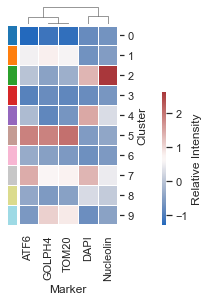

In [34]:
import scipy.cluster.hierarchy as sch
import matplotlib

# Calulate the figure size, this gets us close, but not quite to the right place
my_cmap = "vlag"
scale_name = "Relative Intensity"

# Get linkage
d = sch.distance.pdist(df_per_label_UC, metric='cosine')
L = sch.linkage(d, method="average")

# Get colormap
vals = np.linspace(0, 1, len(df_per_label_UC))
my_cmap_row = plt.cm.tab20(vals)

# Clustermap and umap
labels = df_per_label_UC.index.to_list()
my_cmap_dict = dict(zip(labels, my_cmap_row))
row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)
cellSizePixels = 20 #10

dpi = matplotlib.rcParams['figure.dpi']
marginWidth = matplotlib.rcParams['figure.subplot.right']-matplotlib.rcParams['figure.subplot.left']
marginHeight = matplotlib.rcParams['figure.subplot.top']-matplotlib.rcParams['figure.subplot.bottom']
Ny,Nx = df_per_label_UC.shape
figWidth = (Nx*cellSizePixels/dpi)/marginWidth
figHeigh = (Ny*cellSizePixels/dpi)/marginHeight

sns.set(font_scale=1)
ax = sns.clustermap(df_per_label_UC,
                    cmap=my_cmap,
                    z_score=1,
                    linewidth=0.5,
                    row_cluster=False,
                    row_colors=[row_colors],
                    dendrogram_ratio=(0.0, 0.1),
                    figsize=(figWidth, figHeigh),
                    colors_ratio=0.15
                    )
ax.ax_heatmap.set_yticklabels(
    ax.ax_heatmap.get_yticklabels(), rotation=0)
ax.ax_heatmap.set_xticklabels(
    ax.ax_heatmap.get_xticklabels(), rotation=90)
ax.ax_heatmap.set_xlabel('Marker')
ax.ax_heatmap.set_ylabel('Cluster')

# calculate the size of the heatmap axes
axWidth = (Nx*cellSizePixels)/(figWidth*dpi)
axHeight = (Ny*cellSizePixels)/(figHeigh*dpi)

# resize heatmap
ax_heatmap_orig_pos = ax.ax_heatmap.get_position()
ax.ax_heatmap.set_position([ax_heatmap_orig_pos.x0, ax_heatmap_orig_pos.y0, 
                              axWidth, axHeight])

# resize dendrograms to match
ax_col_orig_pos = ax.ax_col_dendrogram.get_position()
ax.ax_col_dendrogram.set_position([ax_col_orig_pos.x0, ax_heatmap_orig_pos.y0+axHeight,
                                     axWidth, ax_col_orig_pos.height])
ax_row_orig_pos = ax.ax_row_colors.get_position()
ax.ax_row_colors.set_position([ax_row_orig_pos.x0, ax_row_orig_pos.y0, 
                                     ax_row_orig_pos.width, axHeight])

pos = ax.ax_heatmap.get_position()
cbar_size=0.5
ax.ax_cbar.set_position((1.3, pos.y0, .03, cbar_size))

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name, fontsize=12)

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)

image_path_png = save_path+"/clustered_UC_cell_heatmap1.png"

ax.savefig(image_path_png, edgecolor='none', bbox_inches="tight")

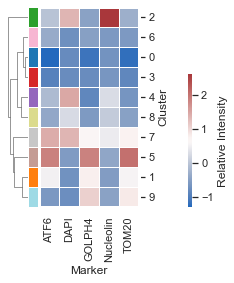

In [35]:
# Clustermap and umap
labels = df_per_label_UC.index.to_list()
my_cmap_dict = dict(zip(labels, my_cmap_row))
row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)
cellSizePixels = 20 #10

dpi = matplotlib.rcParams['figure.dpi']
marginWidth = matplotlib.rcParams['figure.subplot.right']-matplotlib.rcParams['figure.subplot.left']
marginHeight = matplotlib.rcParams['figure.subplot.top']-matplotlib.rcParams['figure.subplot.bottom']
Ny,Nx = df_per_label_UC.shape
figWidth = (Nx*cellSizePixels/dpi)/marginWidth
figHeigh = (Ny*cellSizePixels/dpi)/marginHeight
sns.set(font_scale=1)
ax = sns.clustermap(df_per_label_UC,
                    cmap=my_cmap,
                    linewidth=0.5,
                    z_score=1,
                    row_cluster=True,
                    col_cluster=False,
                    row_colors=[row_colors],
                    dendrogram_ratio=(0.3, 0.0),
                    figsize=(figWidth, figHeigh),
                    colors_ratio=0.15,
                    xticklabels=True, yticklabels=True
                    )
ax.ax_heatmap.set_yticklabels(
    ax.ax_heatmap.get_yticklabels(), rotation=0)
ax.ax_heatmap.set_xticklabels(
    ax.ax_heatmap.get_xticklabels(), rotation=90)
ax.ax_heatmap.set_xlabel('Marker')
ax.ax_heatmap.set_ylabel('Cluster')

# calculate the size of the heatmap axes
axWidth = (Nx*cellSizePixels)/(figWidth*dpi)
axHeight = (Ny*cellSizePixels)/(figHeigh*dpi)

# resize heatmap
ax_heatmap_orig_pos = ax.ax_heatmap.get_position()
ax.ax_heatmap.set_position([ax_heatmap_orig_pos.x0, ax_heatmap_orig_pos.y0, 
                              axWidth, axHeight])

# resize dendrograms to match
ax_row_orig_pos = ax.ax_row_dendrogram.get_position()
ax.ax_row_dendrogram.set_position([ax_row_orig_pos.x0, ax_heatmap_orig_pos.y0,
                                     ax_row_orig_pos.width, axHeight])
ax_row_orig_pos = ax.ax_row_colors.get_position()
ax.ax_row_colors.set_position([ax_row_orig_pos.x0, ax_row_orig_pos.y0, 
                                     ax_row_orig_pos.width, axHeight])

pos = ax.ax_heatmap.get_position()
cbar_size=0.5
ax.ax_cbar.set_position((1.5, pos.y0, .03, cbar_size))

# Change colorbar label position
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.set_label(scale_name, fontsize=12)

for _, spine in ax.ax_heatmap.spines.items():
    spine.set_visible(True)
    spine.set_linewidth(3)

image_path_png = save_path+"/clustered_UC_cell_heatmap2.png"

ax.savefig(image_path_png, edgecolor='none', bbox_inches="tight")